In [1]:
import torch
import cv2
import pandas as pd
import numpy as np

In [2]:
model = torch.hub.load('ultralytics/yolov5', 'custom', path = './yolov5_logo.pt')

im = './pepsi_logo.jpg'

results = model(im)

Using cache found in C:\Users\prajwalj/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-1-27 Python-3.9.13 torch-1.13.1+cpu CPU

Fusing layers... 
Model summary: 157 layers, 7050580 parameters, 0 gradients
Adding AutoShape... 


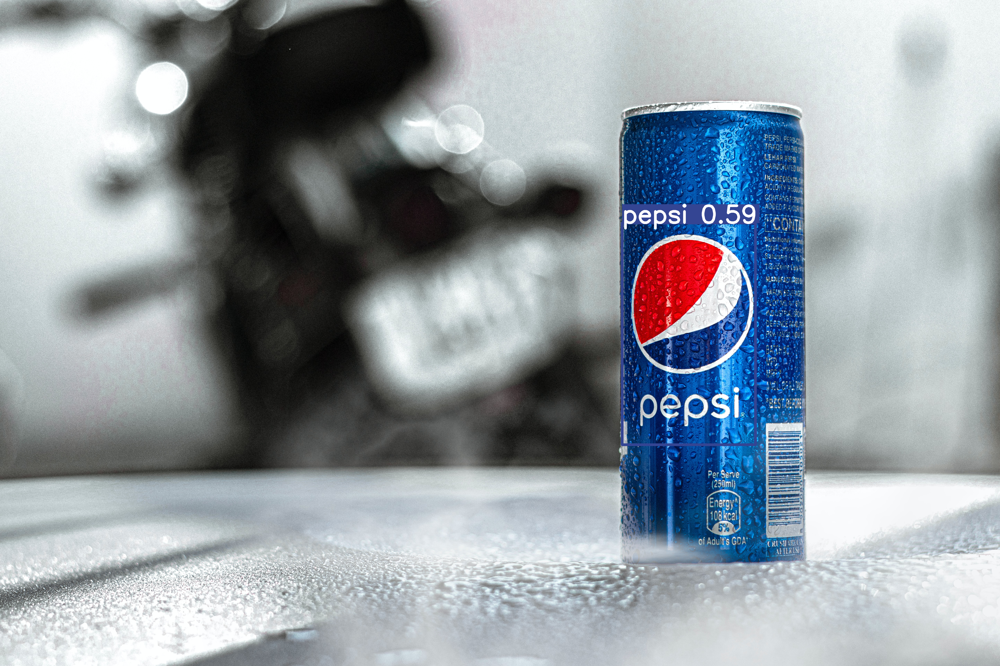

In [4]:
results.show()

In [5]:
image = cv2.imread("./pepsi_logo.jpg")

In [6]:
blurred_image = cv2.blur(image,(555, 555))

In [7]:
for box in results.xyxy[0]: 
    xB = int(box[2])
    xA = int(box[0])
    yB = int(box[3])
    yA = int(box[1])

    w = xB - xA
    h = yA - yB

    roi_corners = np.array([[(xA, yA - h), (xA, yA), (xB, yB + h), (xB, yB)]], dtype=np.int32)

    mask = np.zeros(image.shape, dtype=np.uint8)
    channel_count = image.shape[2]
    ignore_mask_color = (255,)*channel_count
    cv2.fillPoly(mask, roi_corners, ignore_mask_color)

    mask_inverse = np.ones(mask.shape).astype(np.uint8)*255 - mask

    final_image = cv2.bitwise_and(blurred_image, mask) + cv2.bitwise_and(image, mask_inverse)

    cv2.imwrite('./out.png', final_image)
    
    

        
        

In [11]:
for box in results.xyxy[0]: 
    xB = int(box[2])
    xA = int(box[0])
    yB = int(box[3])
    yA = int(box[1])

    # calculates widht and height of the bounding box
    w = xB - xA
    h = yA - yB

    # drawing the bounding box with a custom color. The tuple (8, 255, 8) is the RGB color code.
    # last paramter 20 is the thickness of the border
    green_bounded_image = cv2.rectangle(image, (xA, yA), (xB, yB), (8,255,8), 20)

    cv2.imwrite('./boundingbox.png', green_bounded_image)